# Import libraries

In [ ]:
import pandas as pd
import numpy as np

import plotly.express as px

import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.feature_selection import mutual_info_classif
from sklearn.feature_selection import SelectKBest, chi2

from sklearn.feature_selection import RFE

from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler

from xgboost import XGBClassifier
from lightgbm import LGBMClassifier

from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import AdaBoostClassifier

from sklearn.metrics import accuracy_score, classification_report, confusion_matrix, roc_auc_score, roc_curve
import matplotlib.pyplot as plt
from imblearn.over_sampling import SMOTENC
from collections import Counter

import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader

# Load Dataset

In [ ]:
df = pd.read_csv("/content/watson_healthcare_modified.csv")
df.head(3)

,EmployeeID,Age,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeCount,...,RelationshipSatisfaction,StandardHours,Shift,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
0,1313919,41,No,Travel_Rarely,1102,Cardiology,1,2,Life Sciences,1,...,1,80,0,8,0,1,6,4,0,5
1,1200302,49,No,Travel_Frequently,279,Maternity,8,1,Life Sciences,1,...,4,80,1,10,3,3,10,7,1,7
2,1060315,37,Yes,Travel_Rarely,1373,Maternity,2,2,Other,1,...,2,80,0,7,3,3,0,0,0,0


# EDA

In [ ]:
print(df.isnull().any())

EmployeeID                  False
Age                         False
Attrition                   False
BusinessTravel              False
DailyRate                   False
Department                  False
DistanceFromHome            False
Education                   False
EducationField              False
EmployeeCount               False
EnvironmentSatisfaction     False
Gender                      False
HourlyRate                  False
JobInvolvement              False
JobLevel                    False
JobRole                     False
JobSatisfaction             False
MaritalStatus               False
MonthlyIncome               False
MonthlyRate                 False
NumCompaniesWorked          False
Over18                      False
OverTime                    False
PercentSalaryHike           False
PerformanceRating           False
RelationshipSatisfaction    False
StandardHours               False
Shift                       False
TotalWorkingYears           False
TrainingTimesL

In [ ]:
# Find columns with only one unique value
cols_to_remove = [col for col in df.columns if df[col].nunique() == 1]

# Remove id column
cols_to_remove.append('EmployeeID')

# Remove the columns
df = df.drop(columns=cols_to_remove)

In [ ]:
df.head(3)

,Age,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EnvironmentSatisfaction,Gender,...,PerformanceRating,RelationshipSatisfaction,Shift,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
0,41,No,Travel_Rarely,1102,Cardiology,1,2,Life Sciences,2,Female,...,3,1,0,8,0,1,6,4,0,5
1,49,No,Travel_Frequently,279,Maternity,8,1,Life Sciences,3,Male,...,4,4,1,10,3,3,10,7,1,7
2,37,Yes,Travel_Rarely,1373,Maternity,2,2,Other,4,Male,...,3,2,0,7,3,3,0,0,0,0


# Visualization

## Bar-diagram

In [ ]:
for column in df.columns:
  if column != 'Attrition':  # Exclude the target attribute
    count = df.groupby([column, 'Attrition']).size().reset_index(name='Count')
    fig = px.bar(count, x=column, y='Count', color='Attrition', title=column, width=600, height=400,
                 color_discrete_map={'No': 'skyblue', 'Yes': 'Purple'})
    fig.show()

These columns need to be analysed from Bar-diagram


* JobLevel
* JobRole
* MaritalStatus
* NumCompaniesWorked
* OverTime
* Shift
* TotalWorkingYears
* YearsAtCompany
* YearsInCurrentRole

## Box-plots

In [ ]:
for column in df.columns:
  if column != 'Attrition' and pd.api.types.is_numeric_dtype(df[column]):
    fig = px.box(df, x='Attrition', y=column, color='Attrition', height=300, width=400,
                 color_discrete_map={'0': 'skyblue', '1': 'Purple'})
    fig.show()

# Encoding

In [ ]:
cols_to_encode = [col for col in df.columns if df[col].dtype == 'object']

print("Columns that may need encoding:")
print(cols_to_encode)

Columns that may need encoding:
['Attrition', 'BusinessTravel', 'Department', 'EducationField', 'Gender', 'JobRole', 'MaritalStatus', 'OverTime']


## Manual

In [ ]:
# Map Attrition to 1 and 0
df['Attrition'] = df['Attrition'].map({'Yes': 1, 'No': 0})

# Map BusinessTravel to ordinal values
business_travel_mapping = {'Non-Travel': 0, 'Travel_Rarely': 1, 'Travel_Frequently': 2}
df['BusinessTravel'] = df['BusinessTravel'].map(business_travel_mapping)

# Map Gender to 1 and 0
df['Gender'] = df['Gender'].map({'Male': 1, 'Female': 0})

# Map OverTime to 1 and 0
df['OverTime'] = df['OverTime'].map({'Yes': 1, 'No': 0})

## One-hot

In [ ]:
boolean_cols = []

for column in df.columns:
    if all(isinstance(x, bool) for x in df[column].unique()):
        boolean_cols.append(column)

print("Columns with 'True', 'False' values:")
print(boolean_cols)

Columns with 'True', 'False' values:
[]


In [ ]:
df_test = df[cols_to_encode]
df_test

,Attrition,BusinessTravel,Department,EducationField,Gender,JobRole,MaritalStatus,OverTime
0,0,1,Cardiology,Life Sciences,0,Nurse,Single,1
1,0,2,Maternity,Life Sciences,1,Other,Married,0
2,1,1,Maternity,Other,1,Nurse,Single,1
3,0,2,Maternity,Life Sciences,0,Other,Married,1
4,0,1,Maternity,Medical,1,Nurse,Married,0
...,...,...,...,...,...,...,...,...
1671,1,1,Neurology,Technical Degree,1,Nurse,Single,1
1672,0,1,Cardiology,Marketing,0,Nurse,Married,1
1673,0,1,Maternity,Life Sciences,0,Other,Single,0
1674,0,1,Neurology,Life Sciences,0,Therapist,Married,0


In [ ]:
# Perform one-hot encoding for the remaining categorical columns
df = pd.get_dummies(df, columns=['Department', 'EducationField', 'JobRole', 'MaritalStatus'], drop_first=True).replace({True: 1, False: 0})

In [ ]:
df.head(3)

,Age,Attrition,BusinessTravel,DailyRate,DistanceFromHome,Education,EnvironmentSatisfaction,Gender,HourlyRate,JobInvolvement,...,EducationField_Marketing,EducationField_Medical,EducationField_Other,EducationField_Technical Degree,JobRole_Administrative,JobRole_Nurse,JobRole_Other,JobRole_Therapist,MaritalStatus_Married,MaritalStatus_Single
0,41,0,1,1102,1,2,2,0,94,3,...,0,0,0,0,0,1,0,0,0,1
1,49,0,2,279,8,1,3,1,61,2,...,0,0,0,0,0,0,1,0,1,0
2,37,1,1,1373,2,2,4,1,92,2,...,0,0,1,0,0,1,0,0,0,1


In [ ]:
for column in df.columns:
    df[column] = df[column].astype(float)

In [ ]:
df.head(3)

,Age,Attrition,BusinessTravel,DailyRate,DistanceFromHome,Education,EnvironmentSatisfaction,Gender,HourlyRate,JobInvolvement,...,EducationField_Marketing,EducationField_Medical,EducationField_Other,EducationField_Technical Degree,JobRole_Administrative,JobRole_Nurse,JobRole_Other,JobRole_Therapist,MaritalStatus_Married,MaritalStatus_Single
0,41.0,0.0,1.0,1102.0,1.0,2.0,2.0,0.0,94.0,3.0,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0
1,49.0,0.0,2.0,279.0,8.0,1.0,3.0,1.0,61.0,2.0,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0
2,37.0,1.0,1.0,1373.0,2.0,2.0,4.0,1.0,92.0,2.0,...,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0


In [ ]:
# saving the current df
df.to_csv('df_encoded.csv', index=False)
#from google.colab import files
#files.download('df_encoded.csv')

# Feature Extraction

## Pearson Correlation

In [ ]:
def calculate_correlation_matrix(df):
  # Calculate the correlation matrix
  corr_matrix = df.corr()

  # Generate a mask for the upper triangle
  mask = corr_matrix.mask(np.triu(np.ones_like(corr_matrix), k=1).astype(bool))

  # Plot the heatmap
  plt.figure(figsize=(35, 35))
  sns.heatmap(mask, annot=True, cmap='coolwarm', fmt=".2f")
  plt.title('Correlation Matrix')
  plt.show()

## Mutual Information

In [ ]:
def calculate_mutual_information(df):
  # Separate features and target
  X = df.drop('Attrition', axis=1)
  y = df['Attrition']

  # Calculate mutual information
  mutual_info = mutual_info_classif(X, y, random_state=111)

  # Create a DataFrame to visualize the results
  mutual_info_df = pd.DataFrame({'Feature': X.columns, 'Mutual Information': mutual_info})
  mutual_info_df = mutual_info_df.sort_values(by='Mutual Information', ascending=False)

  # Plot the mutual information scores
  plt.figure(figsize=(10, 8))
  sns.barplot(x='Mutual Information', y='Feature', data=mutual_info_df)
  plt.title('Mutual Information with Attrition')
  plt.show()
  return mutual_info_df

## Chi-squared Test

In [ ]:
def calculate_chi_squared(df):
  chi_squared_df = df

  # Separate features and target
  X = chi_squared_df.drop('Attrition', axis=1)
  y = chi_squared_df['Attrition']

  # Apply Chi-Square test
  chi2_selector = SelectKBest(chi2, k='all')  # Select all features based on Chi-Square scores
  X_kbest = chi2_selector.fit_transform(X, y)

  # Display Chi-Square scores for each feature
  chi2_scores = chi2_selector.scores_
  p_values = chi2_selector.pvalues_

  # Create a DataFrame to show the feature names, Chi-Square scores, and p-values
  results = pd.DataFrame({
      'Feature': X.columns,
      'Chi-Square Score': chi2_scores,
      'p-value': p_values
  })

  # Sort the results DataFrame by Chi-Square Score
  results_sorted = results.sort_values(by='Chi-Square Score', ascending=False)

  # Plot the Chi-Square scores
  plt.figure(figsize=(8, 10))
  #plt.bar(results_sorted['Feature'], results_sorted['Chi-Square Score'])
  sns.barplot(x=results_sorted['Chi-Square Score'], y=results_sorted['Feature'])
  plt.xlabel('Chi-Squared Score (log-scaled)')
  plt.ylabel('Features')
  plt.title('Chi-Squared Scores for Features')
  plt.xscale('log')  # Use logarithmic scale for better visualization of small values
  plt.show()

  #more_significant_features = results[results['p-value'] < 0.05]
  less_significant_features = results[results['p-value'] >= 0.5]

  print(less_significant_features)
  return less_significant_features

## Recursive Feature Elimination

In [ ]:
def do_rfe(df):
  # Separate features and target
  X = df.drop('Attrition', axis=1)
  y = df['Attrition']

  rfe = RFE(estimator=DecisionTreeClassifier(), n_features_to_select=30)
  # fit RFE
  rfe.fit(X, y)
  selected_features = X.columns[rfe.support_]
  # Print the selected features
  print("Selected features:", selected_features)
  # summarize all features
  for i in range(X.shape[1]):
    print('Column: %d, Selected %s, Rank: %.3f' % (i, rfe.support_[i], rfe.ranking_[i]))
  features_not_selected = [feature for feature in X.columns if feature not in selected_features]
  print("Features not selected:", features_not_selected)

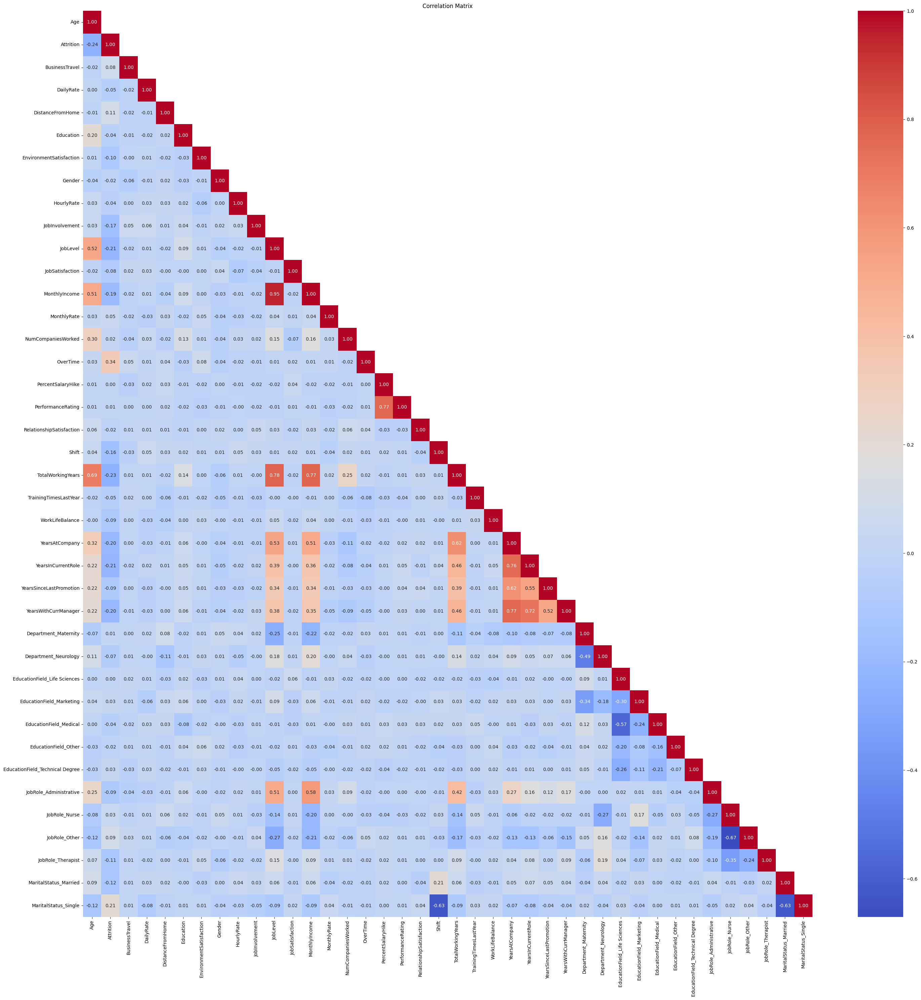

In [ ]:
calculate_correlation_matrix(df)

Monthly Income and JobLevel have high correlation -> need to remove one of them

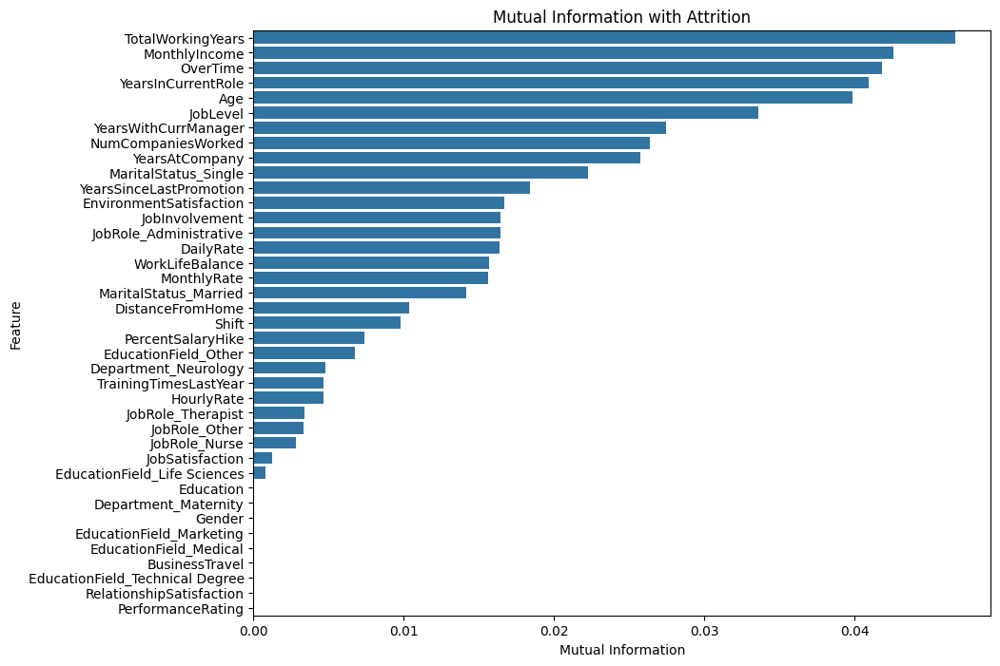

Columns with zero mutual information:
['Education', 'Department_Maternity', 'Gender', 'EducationField_Marketing', 'EducationField_Medical', 'BusinessTravel', 'EducationField_Technical Degree', 'RelationshipSatisfaction', 'PerformanceRating']


In [ ]:
mutual_info_df = calculate_mutual_information(df)
zero_mi_features = mutual_info_df[mutual_info_df['Mutual Information'] == 0]['Feature'].tolist()
print("Columns with zero mutual information:")
print(zero_mi_features)

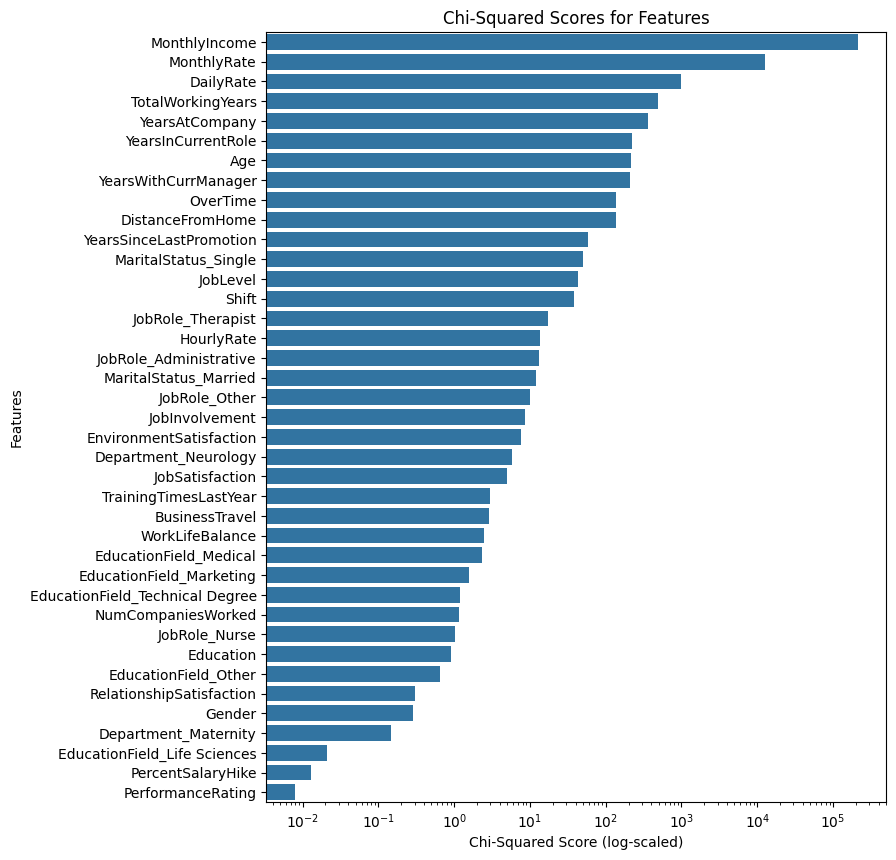

                         Feature  Chi-Square Score   p-value
6                         Gender          0.289423  0.590591
15             PercentSalaryHike          0.012698  0.910279
16             PerformanceRating          0.007821  0.929528
17      RelationshipSatisfaction          0.299901  0.583944
26          Department_Maternity          0.145973  0.702413
28  EducationField_Life Sciences          0.021139  0.884402


In [ ]:
less_significant_features_chi2 = calculate_chi_squared(df)

In [ ]:
features_to_remove = ['Education', 'PercentSalaryHike', 'PerformanceRating', 'EducationField_Life Sciences', 'EducationField_Medical', 'EducationField_Technical Degree', 'Department_Maternity', 'Gender', 'RelationshipSatisfaction', 'PercentSalaryHike']

In [ ]:
df = df.drop(columns=list(features_to_remove))

In [ ]:
#its box plot says it has more anomalous data, so dropping 'MonthlyIncome'
df = df.drop(columns=['MonthlyIncome'])

In [ ]:
# saving the current df
df.to_csv('df_encoded_dropped.csv', index=False)
#from google.colab import files
#files.download('df_encoded.csv')

# Handling Outliers

## Box-cox transformation

In [ ]:
df = pd.read_csv('/content/df_encoded_dropped.csv')

In [ ]:
numerical_features = [col for col in df.columns if df[col].nunique() > 10]

In [ ]:
#box_cox_to_original = df[numerical_features]

=== Age ===


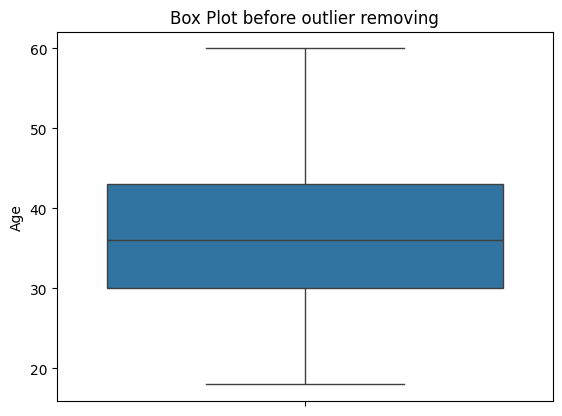

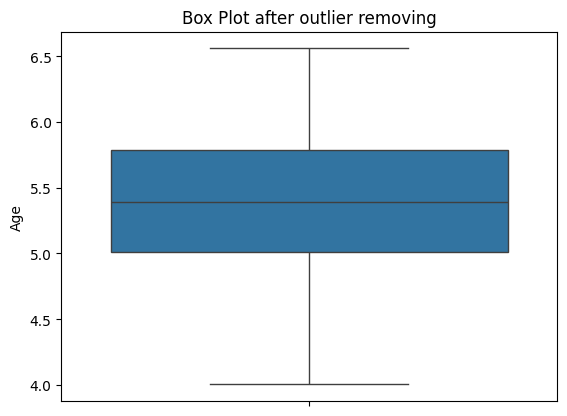

=== DailyRate ===


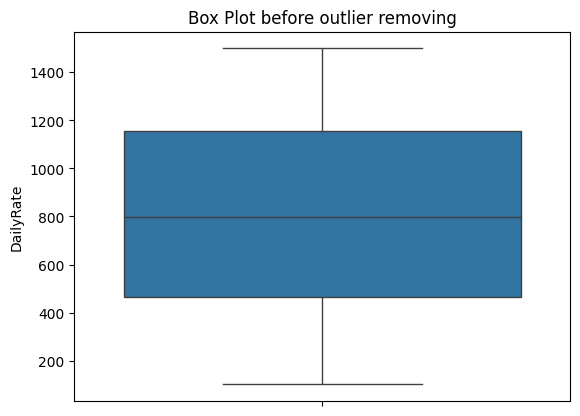

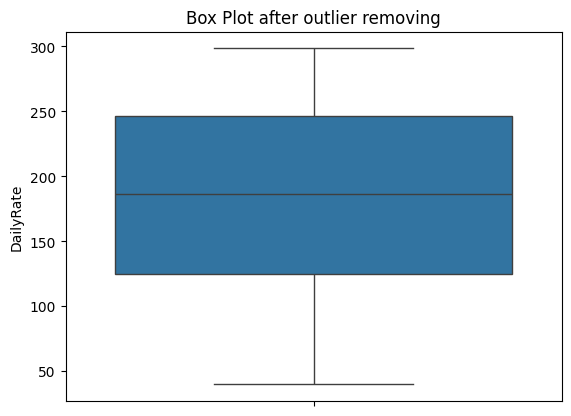

=== DistanceFromHome ===


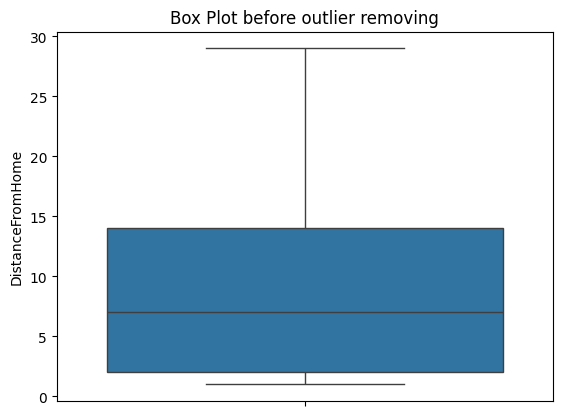

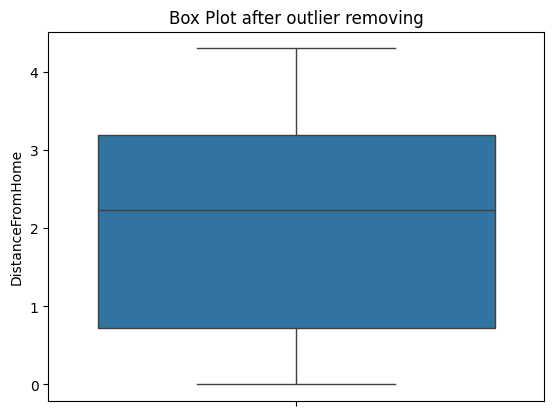

=== HourlyRate ===


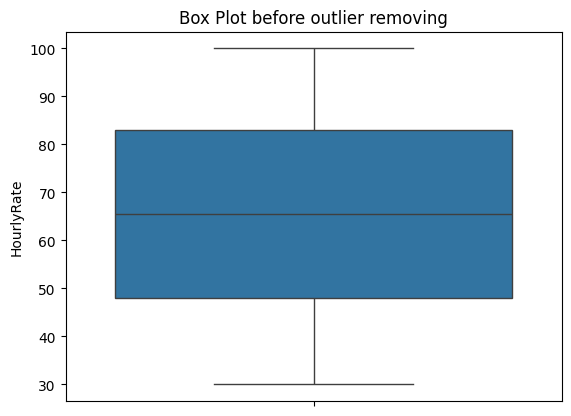

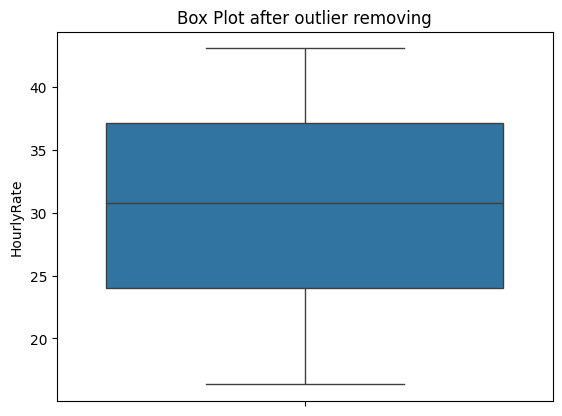

=== MonthlyRate ===


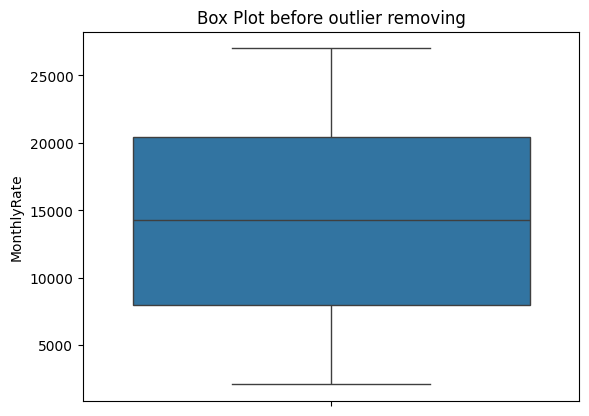

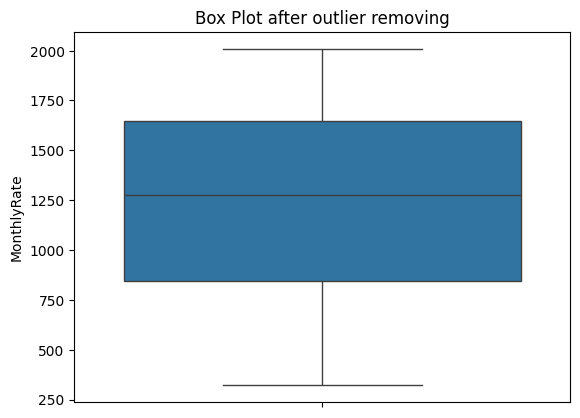

=== TotalWorkingYears ===


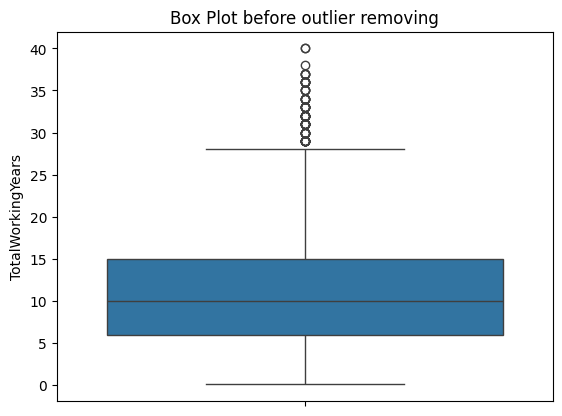

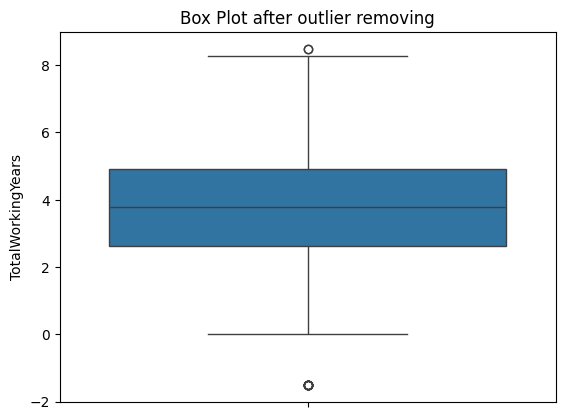

=== YearsAtCompany ===


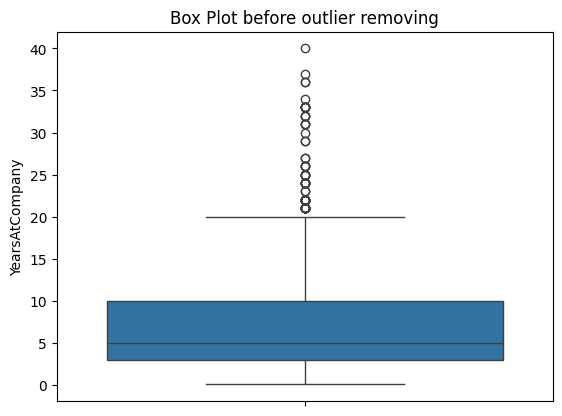

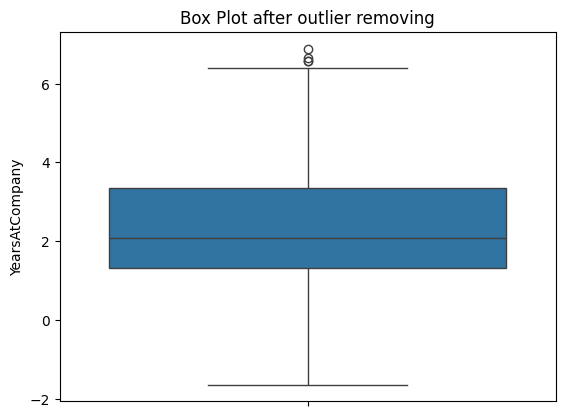

=== YearsInCurrentRole ===


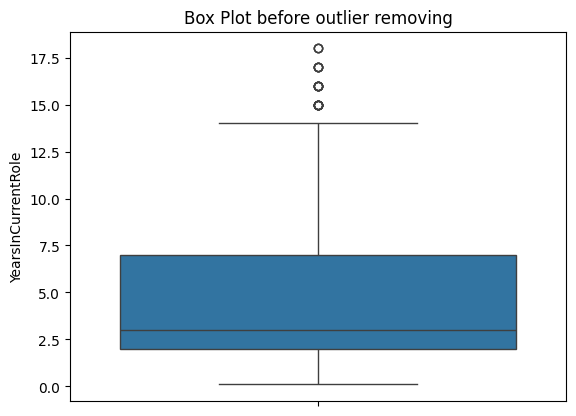

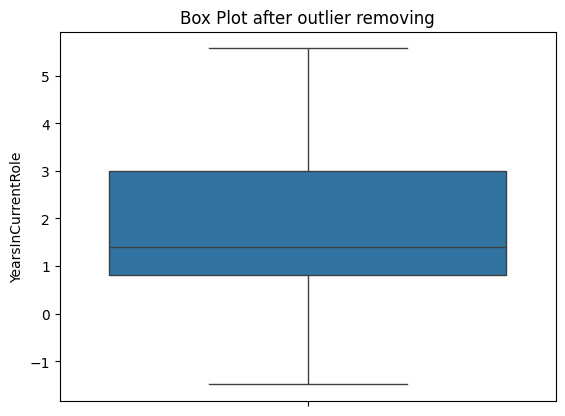

=== YearsSinceLastPromotion ===


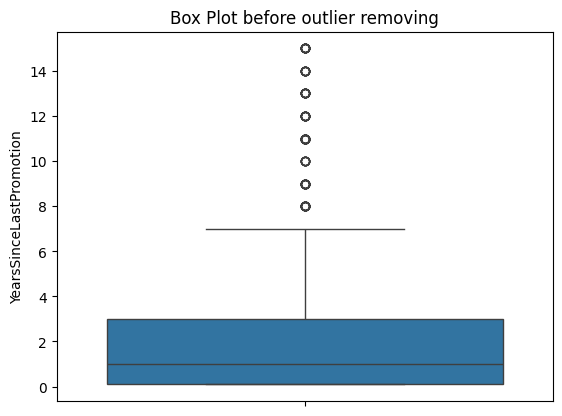

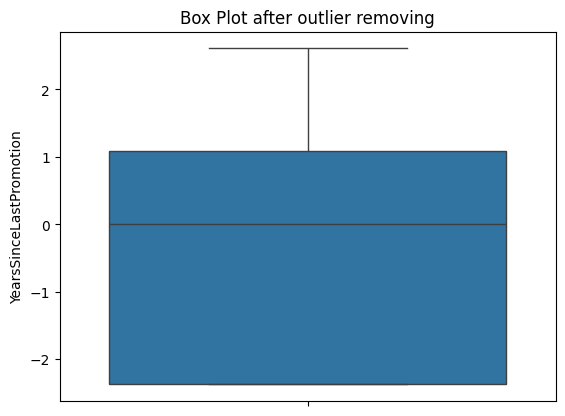

=== YearsWithCurrManager ===


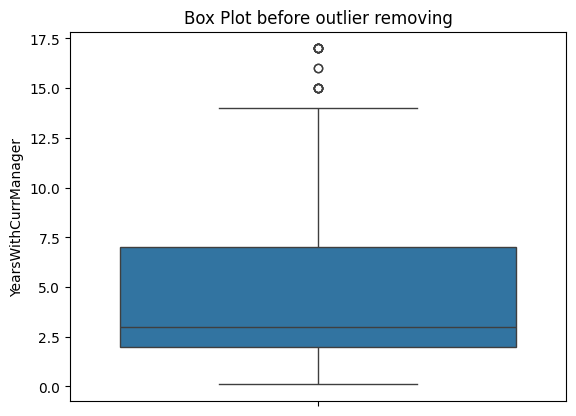

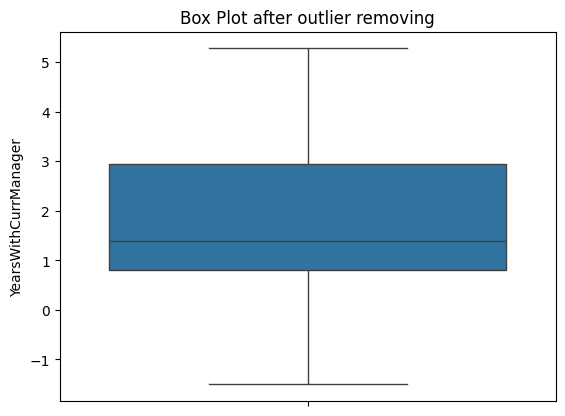

In [ ]:
#Box-transformation
import scipy
for col in df.columns:
  if col in numerical_features:
    print(f"=== {col} ===")
    df.loc[df[col] == 0, col] = 0.1

    #box_cox_to_original[col] = df[col].copy()

    sns.boxplot(df[col])
    plt.title("Box Plot before outlier removing")
    plt.show()
    df[col],fitted_lambda= scipy.stats.boxcox(df[col] ,lmbda=None)
    sns.boxplot(df[col])
    plt.title("Box Plot after outlier removing")
    plt.show()

In [ ]:
# prompt: handle outliers in df

#def handle_outliers_iqr(df, column):
  #"""Handles outliers using the Interquartile Range (IQR) method.

  #Args:
  #  df: The DataFrame containing the data.
  #  column: The name of the column to handle outliers for.

  #Returns:
  #  The DataFrame with outliers replaced by the nearest bound.
  #"""
  #print(f"=== {column} ===")
  #Q1 = df[column].quantile(0.25)
  #Q3 = df[column].quantile(0.75)
  #IQR = Q3 - Q1
  #lower_bound = Q1 - 1.5 * IQR
  #upper_bound = Q3 + 1.5 * IQR

  #print(f"lower-outliers: {np.where(df[column] < lower_bound)}")
  #print(f"lower-bound: {lower_bound}")
  #print(f"higher-outliers: {np.where(df[column] > upper_bound)[0]}")
  #print(f"upper-bound: {upper_bound}")

  # Replace outliers with the nearest bound
  #df[column] = np.where(df[column] < lower_bound, lower_bound, df[column])
  #df[column] = np.where(df[column] > upper_bound, upper_bound, df[column])
  #return df

#df_dummy = df
# Apply outlier handling to numerical columns
#for column in numerical_features:
  #df = handle_outliers_iqr(df, column)


In [ ]:
"""from sklearn.ensemble import IsolationForest
import numpy as np
import pandas as pd
train = df
def Iso_outliers(df):
    print(f"=== {df.name} ===")
    iso = IsolationForest(random_state = 1, contamination= 'auto')
    preds = iso.fit_predict(df.values.reshape(-1,1))
    data = pd.DataFrame()
    data['cluster'] = preds
    print(data['cluster'].value_counts().sort_values(ascending=False))

df_dummy = df.copy()
# Apply outlier handling to numerical columns
for column in df_dummy.columns:
  if pd.api.types.is_numeric_dtype(df_dummy[column]):
    Iso_outliers(df_dummy[column])"""

'from sklearn.ensemble import IsolationForest\nimport numpy as np\nimport pandas as pd\ntrain = df\ndef Iso_outliers(df):\n    print(f"=== {df.name} ===")\n    iso = IsolationForest(random_state = 1, contamination= \'auto\')\n    preds = iso.fit_predict(df.values.reshape(-1,1))\n    data = pd.DataFrame()\n    data[\'cluster\'] = preds\n    print(data[\'cluster\'].value_counts().sort_values(ascending=False))\n\ndf_dummy = df.copy()\n# Apply outlier handling to numerical columns\nfor column in df_dummy.columns:\n  if pd.api.types.is_numeric_dtype(df_dummy[column]):\n    Iso_outliers(df_dummy[column])'

In [ ]:
# saving the current df
#df.to_csv('df_encoded_dropped_outlhandled.csv', index=False)
#from google.colab import files
#files.download('df_encoded.csv')

# Train-Test Split

In [ ]:
#df = pd.read_csv('/content/df_encoded_dropped_outlhandled.csv')

In [ ]:
X = df.drop('Attrition', axis=1)
y = df['Attrition']

# Split the data into training and testing sets with 80:20 ratio and stratification
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42, stratify=y)

# Upsampling with SMOTE-NC

In [ ]:
def Apply_SMOTE_NC(X,y):
  # Identify the indices of categorical features
  categorical_features = [col for col in X.columns if X[col].nunique() < 10]

  # Apply SMOTENC to the training data
  smote_nc = SMOTENC(categorical_features=categorical_features, random_state=42)
  X_res_smote_nc, y_res_smote_nc = smote_nc.fit_resample(X, y)

  # Check the class distribution after SMOTENC
  print(f"Resampled class distribution (SMOTENC): {Counter(y_res_smote_nc)}")
  #df = pd.concat([X_res_smote_nc, y_res_smote_nc], axis=1)
  return X_res_smote_nc, y_res_smote_nc

# Normalize with Z-score

In [ ]:
def Normalize_data(df):
  columns_to_normalize = [col for col in df.columns if df[col].nunique() > 10]
  # Standardization (Z-score normalization)
  scaler = StandardScaler()
  df[columns_to_normalize] = scaler.fit_transform(df[columns_to_normalize])
  return df

# Training

## Machine Learning

In [ ]:
!pip install catboost

In [ ]:
from catboost import CatBoostClassifier

In [ ]:
models = {
      'Logistic Regression': LogisticRegression(random_state=42),
      'SVM': SVC(probability=True, random_state=42),  # Enable probability estimates for ROC-AUC
      'KNN': KNeighborsClassifier(),
      'Decision Tree': DecisionTreeClassifier(random_state=42),

      'Random Forest': RandomForestClassifier(random_state=42),

      'Gradient Boosting': GradientBoostingClassifier(random_state=42),
      'Ada Boost': AdaBoostClassifier(random_state=42),
      'XGBoost': XGBClassifier(random_state=42),
      'LightGBM': LGBMClassifier(random_state=42),
      'CatBoost': CatBoostClassifier(verbose=0, random_state=42)
  }

def Train_model(X_train, X_test, y_train, y_test):
  # Train and evaluate each model
  for name, model in models.items():
      model.fit(X_train, y_train)
      y_pred = model.predict(X_test)

      print(f"--- {name} ---")
      print(f"Accuracy: {accuracy_score(y_test, y_pred)}")
      print(classification_report(y_test, y_pred))

      # Confusion Matrix
      cm = confusion_matrix(y_test, y_pred)
      print("Confusion Matrix:")
      print(cm)

      # ROC-AUC
      y_pred_proba = model.predict_proba(X_test)[:, 1]
      roc_auc = roc_auc_score(y_test, y_pred_proba)
      print(f"ROC-AUC: {roc_auc}")

      # ROC Curve
      fpr, tpr, thresholds = roc_curve(y_test, y_pred_proba)
      plt.plot(fpr, tpr, label=f'{name} (AUC = {roc_auc:.2f})')

  # Plot ROC Curve
  plt.plot([0, 1], [0, 1], 'k--')
  plt.xlabel('False Positive Rate')
  plt.ylabel('True Positive Rate')
  plt.title('ROC Curve')
  plt.legend(loc='lower right')
  plt.show()

In [ ]:
X_train = Normalize_data(X_train)
X_test = Normalize_data(X_test)

In [ ]:
X_train, y_train = Apply_SMOTE_NC(X_train, y_train)

Resampled class distribution (SMOTENC): Counter({0.0: 1181, 1.0: 1181})


--- Logistic Regression ---
Accuracy: 0.8958333333333334
              precision    recall  f1-score   support

         0.0       0.96      0.92      0.94       296
         1.0       0.55      0.75      0.63        40

    accuracy                           0.90       336
   macro avg       0.75      0.83      0.79       336
weighted avg       0.91      0.90      0.90       336

Confusion Matrix:
[[271  25]
 [ 10  30]]
ROC-AUC: 0.908910472972973
--- SVM ---
Accuracy: 0.8898809523809523
              precision    recall  f1-score   support

         0.0       0.96      0.91      0.94       296
         1.0       0.53      0.72      0.61        40

    accuracy                           0.89       336
   macro avg       0.74      0.82      0.77       336
weighted avg       0.91      0.89      0.90       336

Confusion Matrix:
[[270  26]
 [ 11  29]]
ROC-AUC: 0.9077280405405406
--- KNN ---
Accuracy: 0.7857142857142857
              precision    recall  f1-score   support

         0.0   

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning:

The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.



--- Ada Boost ---
Accuracy: 0.8928571428571429
              precision    recall  f1-score   support

         0.0       0.95      0.92      0.94       296
         1.0       0.54      0.68      0.60        40

    accuracy                           0.89       336
   macro avg       0.75      0.80      0.77       336
weighted avg       0.91      0.89      0.90       336

Confusion Matrix:
[[273  23]
 [ 13  27]]
ROC-AUC: 0.9078125
--- XGBoost ---
Accuracy: 0.8898809523809523
              precision    recall  f1-score   support

         0.0       0.94      0.93      0.94       296
         1.0       0.53      0.57      0.55        40

    accuracy                           0.89       336
   macro avg       0.74      0.75      0.75       336
weighted avg       0.89      0.89      0.89       336

Confusion Matrix:
[[276  20]
 [ 17  23]]
ROC-AUC: 0.9053631756756757
[LightGBM] [Info] Number of positive: 1181, number of negative: 1181
[LightGBM] [Info] Auto-choosing row-wise multi-threading

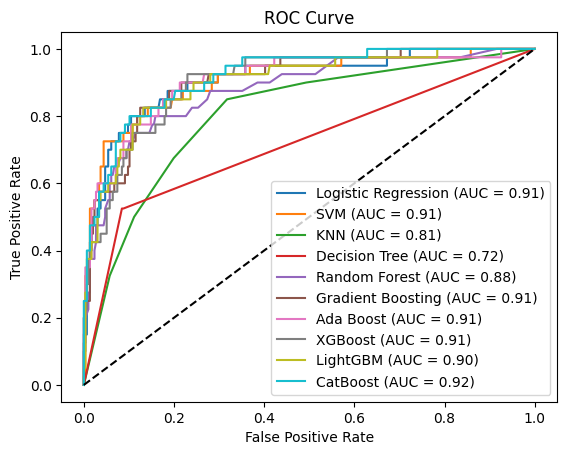

In [ ]:
Train_model(X_train, X_test, y_train, y_test)

## Hybrid

Accuracy: 0.9077380952380952
              precision    recall  f1-score   support

         0.0       0.95      0.95      0.95       296
         1.0       0.61      0.62      0.62        40

    accuracy                           0.91       336
   macro avg       0.78      0.79      0.78       336
weighted avg       0.91      0.91      0.91       336

Confusion Matrix:
[[280  16]
 [ 15  25]]
ROC-AUC: 0.9045185810810811


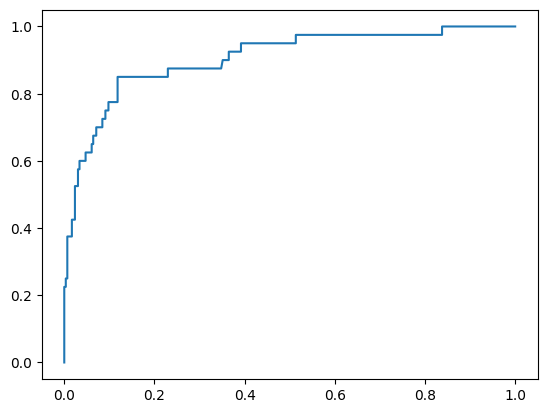

In [ ]:
from sklearn.ensemble import StackingClassifier

# Define base models
base_models = [
    ('rf', RandomForestClassifier(n_estimators=100, random_state=42)),
    ('cat', CatBoostClassifier(verbose=0, random_state=42)),
    ('svc', SVC(probability=True, random_state=42))
]

# Define meta-model
meta_model = LogisticRegression(random_state=42)

# Initialize and train the StackingClassifier
model = StackingClassifier(estimators=base_models, final_estimator=meta_model)
model.fit(X_train, y_train)

y_pred = model.predict(X_test)

print(f"Accuracy: {accuracy_score(y_test, y_pred)}")
print(classification_report(y_test, y_pred))

# Confusion Matrix
cm = confusion_matrix(y_test, y_pred)
print("Confusion Matrix:")
print(cm)

# ROC-AUC
y_pred_proba = model.predict_proba(X_test)[:, 1]
roc_auc = roc_auc_score(y_test, y_pred_proba)
print(f"ROC-AUC: {roc_auc}")

# ROC Curve
fpr, tpr, thresholds = roc_curve(y_test, y_pred_proba)
plt.plot(fpr, tpr, label=f'Stacking (AUC = {roc_auc:.2f})')

## Deep Learning

In [ ]:
class TabularDataset(Dataset):
    def __init__(self, X, y):
        self.X = torch.tensor(X.values, dtype=torch.float32)
        self.y = torch.tensor(y.values, dtype=torch.float32)

    def __len__(self):
        return len(self.X)

    def __getitem__(self, idx):
        return self.X[idx], self.y[idx]

### MLP

In [ ]:
class MLP(nn.Module):
    def __init__(self, input_size, hidden_size1, hidden_size2, output_size):
        super(MLP, self).__init__()
        self.fc1 = nn.Linear(input_size, hidden_size1)
        self.relu = nn.ReLU()
        self.batchNorm1 = nn.BatchNorm1d(hidden_size1)
        self.fc2 = nn.Linear(hidden_size1, hidden_size2)
        self.batchNorm2 = nn.BatchNorm1d(hidden_size2)
        self.fc3 = nn.Linear(hidden_size2, hidden_size2)
        self.batchNorm2 = nn.BatchNorm1d(hidden_size2)
        self.fc4 = nn.Linear(hidden_size2, output_size)
        self.sigmoid = nn.Sigmoid()

    def forward(self, x):
        x = self.fc1(x)
        x = self.relu(x)
        x = self.batchNorm1(x)

        x = self.fc2(x)
        x = self.relu(x)
        x = self.batchNorm2(x)

        x = self.fc4(x)
        x = self.sigmoid(x)
        return x

def Train_MLP(X_train, y_train, X_test, y_test):
  X = X_train
  y = y_train
  X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.10, random_state=42)
  train_dataset = TabularDataset(X_train, y_train)
  val_dataset = TabularDataset(X_val, y_val)

  train_loader = DataLoader(train_dataset, batch_size=16, shuffle=True)
  val_loader = DataLoader(val_dataset, batch_size=16, shuffle=False)

  input_size = X.shape[1]
  hidden_size1 = 20
  hidden_size2 = 20
  output_size = 1

  model = MLP(input_size, hidden_size1, hidden_size2, output_size)
  criterion = nn.BCELoss()
  optimizer = optim.Adam(model.parameters(), lr=0.0001)

  num_epochs = 30
  train_losses = []
  val_losses = []

  for epoch in range(num_epochs):
      model.train()
      train_loss_epoch = 0
      for batch_X, batch_y in train_loader:
          optimizer.zero_grad()
          outputs = model(batch_X)
          loss = criterion(outputs, batch_y.unsqueeze(1))
          loss.backward()
          optimizer.step()
          train_loss_epoch += loss.item()
      train_losses.append(train_loss_epoch / len(train_loader))

      model.eval()
      val_loss_epoch = 0
      with torch.no_grad():
          for batch_X, batch_y in val_loader:
              outputs = model(batch_X)
              loss = criterion(outputs, batch_y.unsqueeze(1))
              val_loss_epoch += loss.item()
          val_losses.append(val_loss_epoch / len(val_loader))
          print(f"Epoch {epoch+1}/{num_epochs}, Training Loss: {train_loss_epoch/len(train_loader)}, Validation Loss: {val_loss_epoch/len(val_loader)}")

  # Evaluate on test data
  test_dataset = TabularDataset(X_test, y_test)
  test_loader = DataLoader(test_dataset, batch_size=32, shuffle=False)

  model.eval()
  with torch.no_grad():
      y_pred_probs = []
      for batch_X, _ in test_loader:
          outputs = model(batch_X)
          y_pred_probs.extend(outputs.tolist())

  # Convert probabilities to binary predictions (e.g., using a threshold of 0.5)
  y_pred = [1 if prob[0] >= 0.5 else 0 for prob in y_pred_probs]

  # Plot the loss curves
  epochs = list(range(1, num_epochs+1))
  df = pd.DataFrame({'TrainLoss': train_losses, 'ValLoss':val_losses, 'Epoch': epochs})
  fig = px.line(df, x='Epoch', y=['TrainLoss', 'ValLoss'], title='Training and Validation Loss')
  fig.show()

  # Calculate accuracy and other metrics
  accuracy = accuracy_score(y_test, y_pred)
  print(f"Test Accuracy: {accuracy}")
  print(classification_report(y_test, y_pred))

  # Confusion Matrix
  cm = confusion_matrix(y_test, y_pred)
  print("Confusion Matrix:")
  print(cm)

  # ROC-AUC
  roc_auc = roc_auc_score(y_test, y_pred)
  print(f"ROC-AUC: {roc_auc}")

  # ROC Curve
  fpr, tpr, thresholds = roc_curve(y_test, y_pred)
  plt.plot(fpr, tpr, label=f'MLP (AUC = {roc_auc:.2f})')

  return model

  # Plot ROC Curve
  """plt.plot([0, 1], [0, 1], 'k--')
  plt.xlabel('False Positive Rate')
  plt.ylabel('True Positive Rate')
  plt.title('ROC Curve')
  plt.legend(loc='lower right')
  plt.show()"""

Epoch 1/30, Training Loss: 0.6661499649062192, Validation Loss: 0.612549877166748
Epoch 2/30, Training Loss: 0.6056929203800689, Validation Loss: 0.561726442972819
Epoch 3/30, Training Loss: 0.5671840505044263, Validation Loss: 0.5227351228396098
Epoch 4/30, Training Loss: 0.5233704911586934, Validation Loss: 0.4834963003794352
Epoch 5/30, Training Loss: 0.48625769359724863, Validation Loss: 0.4453299363454183
Epoch 6/30, Training Loss: 0.45068984305051935, Validation Loss: 0.40889478524525963
Epoch 7/30, Training Loss: 0.4175083274231817, Validation Loss: 0.3751007537047068
Epoch 8/30, Training Loss: 0.3947607698969375, Validation Loss: 0.343124920129776
Epoch 9/30, Training Loss: 0.3608949502607934, Validation Loss: 0.32086907426516215
Epoch 10/30, Training Loss: 0.3282586224097058, Validation Loss: 0.3037519961595535
Epoch 11/30, Training Loss: 0.32417998042769897, Validation Loss: 0.28505213956038156
Epoch 12/30, Training Loss: 0.30859708673971936, Validation Loss: 0.25601758460203

Test Accuracy: 0.9166666666666666
              precision    recall  f1-score   support

         0.0       0.96      0.95      0.95       296
         1.0       0.64      0.68      0.66        40

    accuracy                           0.92       336
   macro avg       0.80      0.81      0.81       336
weighted avg       0.92      0.92      0.92       336

Confusion Matrix:
[[281  15]
 [ 13  27]]
ROC-AUC: 0.8121621621621622


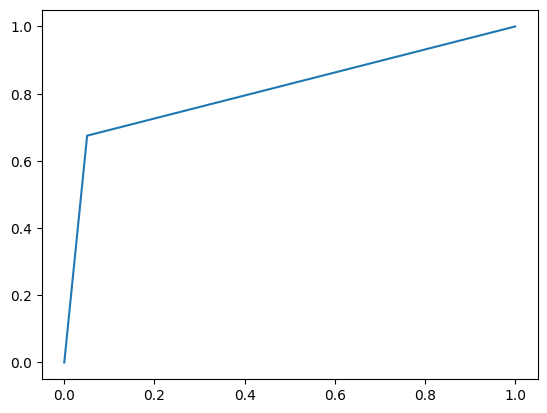

In [ ]:
mlp_model = Train_MLP(X_train, y_train, X_test, y_test)

### CNN

In [ ]:
class TabularCNN(nn.Module):
    def __init__(self, input_size, num_filters, kernel_size, output_size):
        super(TabularCNN, self).__init__()
        self.conv1 = nn.Conv1d(1, num_filters, kernel_size)
        self.relu = nn.ReLU()
        self.maxpool = nn.MaxPool1d(kernel_size=2)
        self.flatten = nn.Flatten()
        self.fc1 = nn.Linear(num_filters * ((input_size - kernel_size + 1) // 2), output_size)
        self.sigmoid = nn.Sigmoid()

    def forward(self, x):
        x = x.unsqueeze(1)  # Add channel dimension for Conv1d
        x = self.conv1(x)
        x = self.relu(x)
        x = self.maxpool(x)
        x = self.flatten(x)
        x = self.fc1(x)
        x = self.sigmoid(x)
        return x

def Train_CNN(X_train, y_train, X_test, y_test):
  X = X_train
  y = y_train
  X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.10, random_state=42)
  train_dataset = TabularDataset(X_train, y_train)
  val_dataset = TabularDataset(X_val, y_val)
  train_loader = DataLoader(train_dataset, batch_size=16, shuffle=True)
  val_loader = DataLoader(val_dataset, batch_size=16, shuffle=False)

  input_size = X.shape[1]
  num_filters = 32
  kernel_size = 4
  output_size = 1

  model = TabularCNN(input_size, num_filters, kernel_size, output_size)
  criterion = nn.BCELoss()
  optimizer = optim.Adam(model.parameters(), lr=0.001)

  num_epochs = 30
  train_losses = []
  val_losses = []

  for epoch in range(num_epochs):
      model.train()
      train_loss_epoch = 0
      for batch_X, batch_y in train_loader:
          optimizer.zero_grad()
          outputs = model(batch_X)
          loss = criterion(outputs, batch_y.unsqueeze(1))
          loss.backward()
          optimizer.step()
          train_loss_epoch += loss.item()
      train_losses.append(train_loss_epoch / len(train_loader))

      model.eval()
      val_loss_epoch = 0
      with torch.no_grad():
          for batch_X, batch_y in val_loader:
              outputs = model(batch_X)
              loss = criterion(outputs, batch_y.unsqueeze(1))
              val_loss_epoch += loss.item()
          val_losses.append(val_loss_epoch / len(val_loader))
          print(f"Epoch {epoch+1}/{num_epochs}, Training Loss: {train_loss_epoch/len(train_loader)}, Validation Loss: {val_loss_epoch/len(val_loader)}")

  # Evaluate on test data
  test_dataset = TabularDataset(X_test, y_test)
  test_loader = DataLoader(test_dataset, batch_size=32, shuffle=False)

  model.eval()
  with torch.no_grad():
      y_pred_probs = []
      for batch_X, _ in test_loader:
          outputs = model(batch_X)
          y_pred_probs.extend(outputs.tolist())
  # Convert probabilities to binary predictions (e.g., using a threshold of 0.5)
  y_pred = [1 if prob[0] >= 0.5 else 0 for prob in y_pred_probs]

  # Plot the loss curves
  epochs = list(range(1, num_epochs+1))
  df = pd.DataFrame({'TrainLoss': train_losses, 'ValLoss':val_losses, 'Epoch': epochs})
  fig = px.line(df, x='Epoch', y=['TrainLoss', 'ValLoss'], title='Training and Validation Loss')
  fig.show()

  # Calculate accuracy and other metrics
  accuracy = accuracy_score(y_test, y_pred)
  print(f"Test Accuracy: {accuracy}")
  print(classification_report(y_test, y_pred))

  # Confusion Matrix
  cm = confusion_matrix(y_test, y_pred)
  print("Confusion Matrix:")
  print(cm)

  # ROC-AUC
  ##y_pred_proba = model.predict_proba(X_test.values)[:, 1]
  roc_auc = roc_auc_score(y_test, y_pred)
  print(f"ROC-AUC: {roc_auc}")

  # ROC Curve
  fpr, tpr, thresholds = roc_curve(y_test, y_pred)
  plt.plot(fpr, tpr, label=f'CNN (AUC = {roc_auc:.2f})')

  # Plot ROC Curve
  """plt.plot([0, 1], [0, 1], 'k--')
  plt.xlabel('False Positive Rate')
  plt.ylabel('True Positive Rate')
  plt.title('ROC Curve')
  plt.legend(loc='lower right')
  plt.show()"""

  return model

Epoch 1/30, Training Loss: 0.4819982697192888, Validation Loss: 0.3625537206729253
Epoch 2/30, Training Loss: 0.34394428783789616, Validation Loss: 0.2806107014417648
Epoch 3/30, Training Loss: 0.2849182098319656, Validation Loss: 0.2337097446123759
Epoch 4/30, Training Loss: 0.2460786507261875, Validation Loss: 0.21025006373723348
Epoch 5/30, Training Loss: 0.22759300173449337, Validation Loss: 0.18388681014378866
Epoch 6/30, Training Loss: 0.20814574302587294, Validation Loss: 0.1764552354812622
Epoch 7/30, Training Loss: 0.19955491910415485, Validation Loss: 0.17028845424453418
Epoch 8/30, Training Loss: 0.18990243258500905, Validation Loss: 0.16806980967521667
Epoch 9/30, Training Loss: 0.18852003459307484, Validation Loss: 0.18206037282943727
Epoch 10/30, Training Loss: 0.1838381983115709, Validation Loss: 0.14666403109828632
Epoch 11/30, Training Loss: 0.17946836688464746, Validation Loss: 0.13999041443069776
Epoch 12/30, Training Loss: 0.17659925140048327, Validation Loss: 0.142

Test Accuracy: 0.8839285714285714
              precision    recall  f1-score   support

         0.0       0.96      0.91      0.93       296
         1.0       0.51      0.72      0.60        40

    accuracy                           0.88       336
   macro avg       0.73      0.82      0.77       336
weighted avg       0.91      0.88      0.89       336

Confusion Matrix:
[[268  28]
 [ 11  29]]
ROC-AUC: 0.8152027027027028


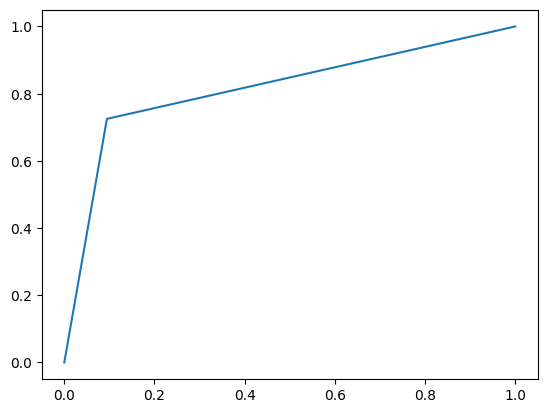

In [ ]:
cnn_model = Train_CNN(X_train, y_train, X_test, y_test)

### Tab-Net

In [ ]:
!pip install pytorch-tabnet

In [ ]:
from pytorch_tabnet.tab_model import TabNetClassifier

def Train_TabNet(X_train, y_train, X_test, y_test):
  # Define the TabNet model
  model = TabNetClassifier()

  # Train the model
  model.fit(
      X_train.values, y_train.values,
      eval_set=[(X_test.values, y_test.values)],
      patience=10, max_epochs=30
  )
  # Make predictions
  y_pred = model.predict(X_test.values)

  print("=== TabNet ===")
  print(f"Accuracy: {accuracy_score(y_test, y_pred)}")
  print(classification_report(y_test, y_pred))

  # Confusion Matrix
  cm = confusion_matrix(y_test, y_pred)
  print("Confusion Matrix:")
  print(cm)

  # ROC-AUC
  y_pred_proba = model.predict_proba(X_test.values)[:, 1]
  roc_auc = roc_auc_score(y_test, y_pred_proba)
  print(f"ROC-AUC: {roc_auc}")

  # ROC Curve
  fpr, tpr, thresholds = roc_curve(y_test, y_pred_proba)
  plt.plot(fpr, tpr, label=f'TabNet (AUC = {roc_auc:.2f})')

  # Plot ROC Curve
  plt.plot([0, 1], [0, 1], 'k--')
  plt.xlabel('False Positive Rate')
  plt.ylabel('True Positive Rate')
  plt.title('ROC Curve')
  plt.legend(loc='lower right')
  plt.show()
  return model

/usr/local/lib/python3.10/dist-packages/pytorch_tabnet/abstract_model.py:82: UserWarning:

Device used : cpu



epoch 0  | loss: 0.8658  | val_0_auc: 0.49295 |  0:00:00s
epoch 1  | loss: 0.67197 | val_0_auc: 0.58332 |  0:00:00s
epoch 2  | loss: 0.60247 | val_0_auc: 0.59607 |  0:00:00s
epoch 3  | loss: 0.55971 | val_0_auc: 0.63927 |  0:00:00s
epoch 4  | loss: 0.53039 | val_0_auc: 0.61693 |  0:00:00s
epoch 5  | loss: 0.50538 | val_0_auc: 0.55781 |  0:00:00s
epoch 6  | loss: 0.48019 | val_0_auc: 0.57504 |  0:00:00s
epoch 7  | loss: 0.45162 | val_0_auc: 0.51182 |  0:00:01s
epoch 8  | loss: 0.40897 | val_0_auc: 0.50971 |  0:00:01s
epoch 9  | loss: 0.37671 | val_0_auc: 0.51533 |  0:00:01s
epoch 10 | loss: 0.35753 | val_0_auc: 0.55519 |  0:00:01s
epoch 11 | loss: 0.33647 | val_0_auc: 0.57513 |  0:00:01s
epoch 12 | loss: 0.32694 | val_0_auc: 0.64303 |  0:00:01s
epoch 13 | loss: 0.32108 | val_0_auc: 0.69033 |  0:00:02s
epoch 14 | loss: 0.29062 | val_0_auc: 0.75274 |  0:00:02s
epoch 15 | loss: 0.28454 | val_0_auc: 0.79396 |  0:00:02s
epoch 16 | loss: 0.28053 | val_0_auc: 0.78847 |  0:00:02s
epoch 17 | los

/usr/local/lib/python3.10/dist-packages/pytorch_tabnet/callbacks.py:172: UserWarning:

Best weights from best epoch are automatically used!



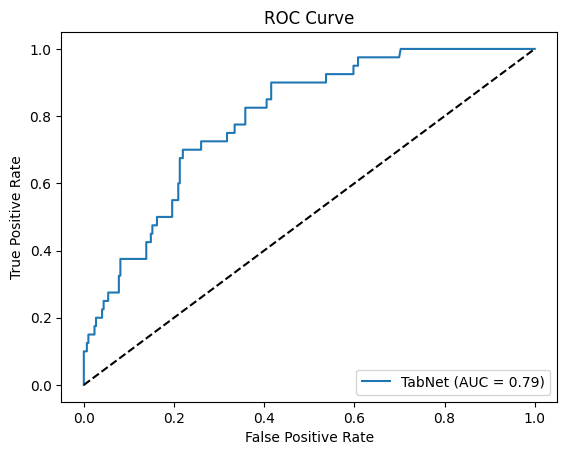

In [ ]:
tabnet_model = Train_TabNet(X_train, y_train, X_test, y_test)

## Defining best models

In [ ]:
best_shallow_model = models['Logistic Regression']
best_ensemble_model = models['CatBoost']
best_dnn_model = cnn_model

# Explainability

## LIME

In [ ]:
!pip install lime

In [ ]:
model = best_shallow_model
model.fit(X_train, y_train)
y_pred = model.predict(X_test)

y_pred_proba = model.predict_proba(X_test)[:, 1]

In [ ]:
from lime import lime_tabular

# Create a LimeTabularExplainer object
explainer = lime_tabular.LimeTabularExplainer(
    X_train.values,
    feature_names=X_train.columns.tolist(),
    class_names=['No Attrition', 'Attrition'],
    mode='classification'
)

In [ ]:
count = 0
no_attrition_indx = []
for instance_idx in range(337):
  if X_test.iloc[instance_idx].values[-1] == 0:
    count += 1
    no_attrition_indx.append(instance_idx)
    explanation = explainer.explain_instance(
    X_test.iloc[instance_idx].values,
      model.predict_proba,
      num_features=10
    )
    # Display the explanation
    explanation.show_in_notebook()
    if count == 5:
      break

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:493: UserWarning:

X does not have valid feature names, but LogisticRegression was fitted with feature names



/usr/local/lib/python3.10/dist-packages/sklearn/base.py:493: UserWarning:

X does not have valid feature names, but LogisticRegression was fitted with feature names



/usr/local/lib/python3.10/dist-packages/sklearn/base.py:493: UserWarning:

X does not have valid feature names, but LogisticRegression was fitted with feature names



/usr/local/lib/python3.10/dist-packages/sklearn/base.py:493: UserWarning:

X does not have valid feature names, but LogisticRegression was fitted with feature names



/usr/local/lib/python3.10/dist-packages/sklearn/base.py:493: UserWarning:

X does not have valid feature names, but LogisticRegression was fitted with feature names



In [ ]:
count = 0
attrition_idx = []
for instance_idx in range(337):
  if X_test.iloc[instance_idx].values[-1] == 1:
    count += 1
    attrition_idx.append(instance_idx)
    explanation = explainer.explain_instance(
    X_test.iloc[instance_idx].values,
      model.predict_proba,
      num_features=10
    )
    # Display the explanation
    explanation.show_in_notebook()
    if count == 5:
      break


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:493: UserWarning:

X does not have valid feature names, but LogisticRegression was fitted with feature names



/usr/local/lib/python3.10/dist-packages/sklearn/base.py:493: UserWarning:

X does not have valid feature names, but LogisticRegression was fitted with feature names



/usr/local/lib/python3.10/dist-packages/sklearn/base.py:493: UserWarning:

X does not have valid feature names, but LogisticRegression was fitted with feature names



/usr/local/lib/python3.10/dist-packages/sklearn/base.py:493: UserWarning:

X does not have valid feature names, but LogisticRegression was fitted with feature names



/usr/local/lib/python3.10/dist-packages/sklearn/base.py:493: UserWarning:

X does not have valid feature names, but LogisticRegression was fitted with feature names



## SHAP

In [ ]:
!pip install shap

In [ ]:
from scipy.special import softmax
import shap

best_models = [best_shallow_model, best_ensemble_model]

shap_values_array = []

for model in best_models:
  # Fits the explainer
  if model == best_dnn_model:
    explainer = shap.DeepExplainer(best_dnn_model, torch.tensor(X_test.values))
    shap_values = explainer.shap_values(X_test)
  else:
    explainer = shap.Explainer(model.predict, X_test)
    shap_values = explainer(X_test)
  shap_values_array.append(shap_values)

def print_feature_importances_shap_values(shap_values, features):
    '''
    Prints the feature importances based on SHAP values in an ordered way
    shap_values -> The SHAP values calculated from a shap.Explainer object
    features -> The name of the features, on the order presented to the explainer
    '''
    # Calculates the feature importance (mean absolute shap value) for each feature
    importances = []
    for i in range(shap_values.values.shape[1]):
        importances.append(np.mean(np.abs(shap_values.values[:, i])))
    # Calculates the normalized version
    importances_norm = softmax(importances)
    # Organize the importances and columns in a dictionary
    feature_importances = {fea: imp for imp, fea in zip(importances, features)}
    feature_importances_norm = {fea: imp for imp, fea in zip(importances_norm, features)}
    # Sorts the dictionary
    feature_importances = {k: v for k, v in sorted(feature_importances.items(), key=lambda item: item[1], reverse = True)}
    feature_importances_norm= {k: v for k, v in sorted(feature_importances_norm.items(), key=lambda item: item[1], reverse = True)}
    # Prints the feature importances
    for k, v in feature_importances.items():
        print(f"{k} -> {v:.4f} (softmax = {feature_importances_norm[k]:.4f})")

PermutationExplainer explainer: 337it [00:29,  6.87it/s]
PermutationExplainer explainer: 337it [00:58,  5.18it/s]


OverTime -> 0.1342 (softmax = 0.0385)
Shift -> 0.0656 (softmax = 0.0360)
Age -> 0.0493 (softmax = 0.0354)
EnvironmentSatisfaction -> 0.0409 (softmax = 0.0351)
YearsInCurrentRole -> 0.0391 (softmax = 0.0350)
JobLevel -> 0.0370 (softmax = 0.0349)
JobInvolvement -> 0.0367 (softmax = 0.0349)
NumCompaniesWorked -> 0.0365 (softmax = 0.0349)
DistanceFromHome -> 0.0315 (softmax = 0.0348)
TotalWorkingYears -> 0.0300 (softmax = 0.0347)
TrainingTimesLastYear -> 0.0229 (softmax = 0.0345)
YearsSinceLastPromotion -> 0.0207 (softmax = 0.0344)
JobSatisfaction -> 0.0200 (softmax = 0.0344)
BusinessTravel -> 0.0191 (softmax = 0.0343)
Department_Neurology -> 0.0187 (softmax = 0.0343)
JobRole_Therapist -> 0.0173 (softmax = 0.0343)
DailyRate -> 0.0084 (softmax = 0.0340)
YearsWithCurrManager -> 0.0071 (softmax = 0.0339)
YearsAtCompany -> 0.0069 (softmax = 0.0339)
WorkLifeBalance -> 0.0067 (softmax = 0.0339)
JobRole_Nurse -> 0.0060 (softmax = 0.0339)
EducationField_Other -> 0.0054 (softmax = 0.0339)
JobRole_A

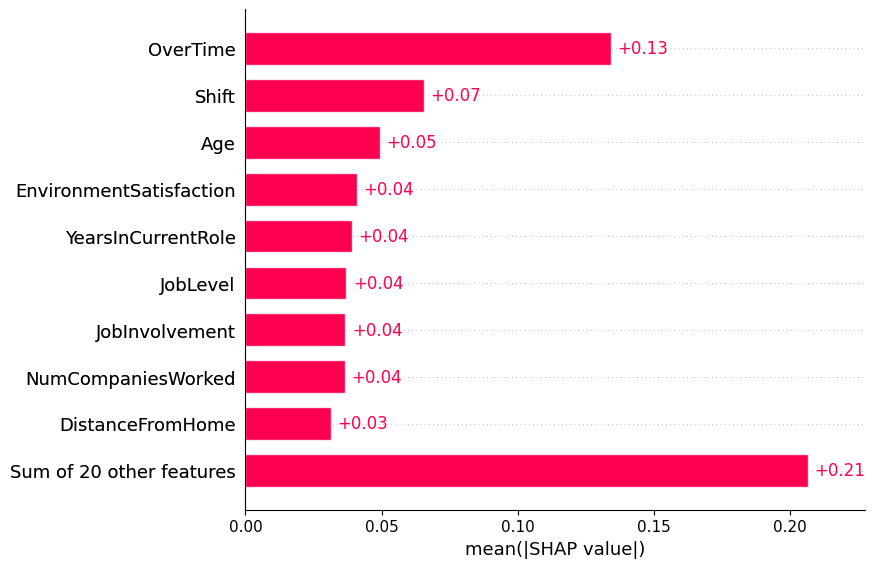

OverTime -> 0.1175 (softmax = 0.0381)
Shift -> 0.0523 (softmax = 0.0357)
JobLevel -> 0.0515 (softmax = 0.0357)
Age -> 0.0428 (softmax = 0.0353)
NumCompaniesWorked -> 0.0304 (softmax = 0.0349)
EnvironmentSatisfaction -> 0.0287 (softmax = 0.0348)
DistanceFromHome -> 0.0250 (softmax = 0.0347)
TrainingTimesLastYear -> 0.0237 (softmax = 0.0347)
TotalWorkingYears -> 0.0200 (softmax = 0.0345)
JobInvolvement -> 0.0158 (softmax = 0.0344)
YearsAtCompany -> 0.0156 (softmax = 0.0344)
Department_Neurology -> 0.0104 (softmax = 0.0342)
YearsWithCurrManager -> 0.0098 (softmax = 0.0342)
JobSatisfaction -> 0.0087 (softmax = 0.0342)
YearsInCurrentRole -> 0.0084 (softmax = 0.0341)
DailyRate -> 0.0077 (softmax = 0.0341)
MaritalStatus_Single -> 0.0066 (softmax = 0.0341)
HourlyRate -> 0.0064 (softmax = 0.0341)
JobRole_Nurse -> 0.0061 (softmax = 0.0341)
WorkLifeBalance -> 0.0058 (softmax = 0.0341)
YearsSinceLastPromotion -> 0.0056 (softmax = 0.0341)
MonthlyRate -> 0.0056 (softmax = 0.0341)
JobRole_Therapist -

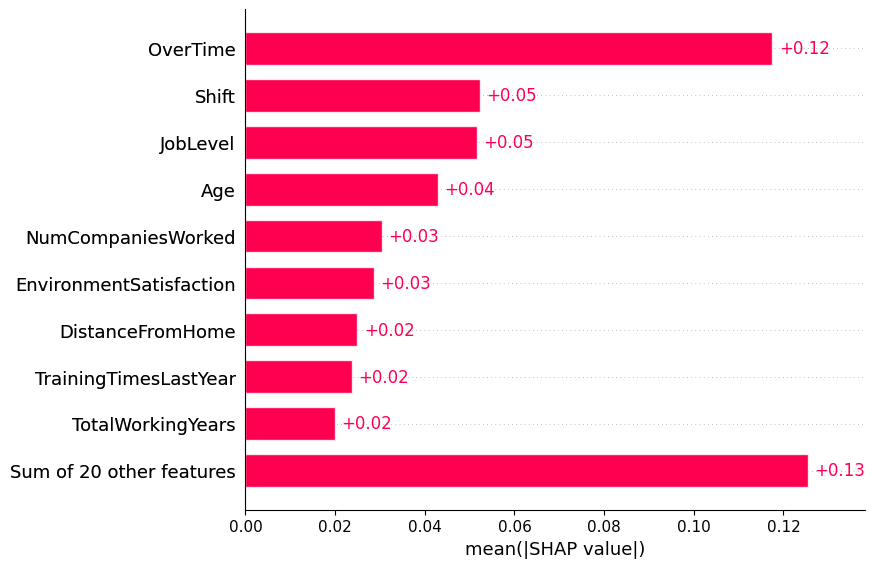

In [ ]:
for shap_values in shap_values_array:
  print_feature_importances_shap_values(shap_values, X_test.columns)
  shap.plots.bar(shap_values)

## Counterfactuals

In [ ]:
!pip install dice-ml

In [ ]:
for column in df.columns:
  print(f"Column '{column}': {df[column].nunique()} unique values")

Column 'Age': 43 unique values
Column 'Attrition': 2 unique values
Column 'BusinessTravel': 3 unique values
Column 'DailyRate': 886 unique values
Column 'DistanceFromHome': 29 unique values
Column 'EnvironmentSatisfaction': 4 unique values
Column 'HourlyRate': 71 unique values
Column 'JobInvolvement': 4 unique values
Column 'JobLevel': 5 unique values
Column 'JobSatisfaction': 4 unique values
Column 'MonthlyRate': 1427 unique values
Column 'NumCompaniesWorked': 10 unique values
Column 'OverTime': 2 unique values
Column 'Shift': 4 unique values
Column 'TotalWorkingYears': 40 unique values
Column 'TrainingTimesLastYear': 7 unique values
Column 'WorkLifeBalance': 4 unique values
Column 'YearsAtCompany': 37 unique values
Column 'YearsInCurrentRole': 19 unique values
Column 'YearsSinceLastPromotion': 16 unique values
Column 'YearsWithCurrManager': 18 unique values
Column 'Department_Neurology': 2 unique values
Column 'EducationField_Marketing': 2 unique values
Column 'EducationField_Other':

In [ ]:
continuous_features = [col for col in df.columns if df[col].nunique() > 8]

In [ ]:
import dice_ml
# Dataset
data_dice = dice_ml.Data(dataframe=df,
                         # For perturbation strategy
                         continuous_features=continuous_features,
                         outcome_name='Attrition')

## For best Shallow Model
rf_dice = dice_ml.Model(model=best_shallow_model,
                        # There exist backends for tf, torch, ...
                        backend="sklearn")
explainer = dice_ml.Dice(data_dice,
                         rf_dice,
                         # Random sampling, genetic algorithm, kd-tree,...
                         method="random")

# Generate CF based on the blackbox model
input_datapoint = X_test[1:2]
cf = explainer.generate_counterfactuals(input_datapoint,
                                  total_CFs=3,
                                  desired_class="opposite")

# Visualize it
cf.visualize_as_dataframe(show_only_changes=True)

100%|██████████| 1/1 [00:00<00:00,  3.51it/s]

Query instance (original outcome : 1.0)


,Age,BusinessTravel,DailyRate,DistanceFromHome,EnvironmentSatisfaction,HourlyRate,JobInvolvement,JobLevel,JobSatisfaction,MonthlyRate,...,Department_Neurology,EducationField_Marketing,EducationField_Other,JobRole_Administrative,JobRole_Nurse,JobRole_Other,JobRole_Therapist,MaritalStatus_Married,MaritalStatus_Single,Attrition
0,-0.946896,1.0,0.305787,0.463427,4.0,1.332198,2.0,1.0,1.0,-0.318523,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0



Diverse Counterfactual set (new outcome: 0.0)


,Age,BusinessTravel,DailyRate,DistanceFromHome,EnvironmentSatisfaction,HourlyRate,JobInvolvement,JobLevel,JobSatisfaction,MonthlyRate,...,Department_Neurology,EducationField_Marketing,EducationField_Other,JobRole_Administrative,JobRole_Nurse,JobRole_Other,JobRole_Therapist,MaritalStatus_Married,MaritalStatus_Single,Attrition
0,6.468182,-,-,-,-,-,-,-,-,-,...,-,-,-,-,-,-,-,-,-,0.0
1,5.193824,-,-,-,-,-,-,-,-,-,...,-,-,-,-,-,-,-,-,-,0.0
2,-,-,150.93364,-,-,-,-,-,-,-,...,-,-,-,-,-,-,-,-,-,0.0


In [ ]:
# Create feasible (conditional) Counterfactuals
features_to_vary=['BusinessTravel',
                  'DailyRate',
                  'EnvironmentSatisfaction',
                  'HourlyRate',
                  'JobInvolvement',
                  'JobLevel',
                  'JobSatisfaction',
                  'MonthlyRate',
                  'OverTime',
                  'Shift',
                  'TrainingTimesLastYear',
                  'WorkLifeBalance',
                  'YearsWithCurrManager']
#permitted_range={'BusinessTravel_Travel_Frequently':[1,5],
#                'TrainingTimesLastYear':[0, 30]}
# Now generating explanations using the new feature weights
cf = explainer.generate_counterfactuals(input_datapoint,
                                  total_CFs=3,
                                  desired_class="opposite",
                                  #permitted_range=permitted_range,
                                  features_to_vary=features_to_vary)
# Visualize it
cf.visualize_as_dataframe(show_only_changes=True)

100%|██████████| 1/1 [00:00<00:00,  4.13it/s]

Query instance (original outcome : 1.0)


,Age,BusinessTravel,DailyRate,DistanceFromHome,EnvironmentSatisfaction,HourlyRate,JobInvolvement,JobLevel,JobSatisfaction,MonthlyRate,...,Department_Neurology,EducationField_Marketing,EducationField_Other,JobRole_Administrative,JobRole_Nurse,JobRole_Other,JobRole_Therapist,MaritalStatus_Married,MaritalStatus_Single,Attrition
0,-0.946896,1.0,0.305787,0.463427,4.0,1.332198,2.0,1.0,1.0,-0.318523,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0



Diverse Counterfactual set (new outcome: 0.0)


,Age,BusinessTravel,DailyRate,DistanceFromHome,EnvironmentSatisfaction,HourlyRate,JobInvolvement,JobLevel,JobSatisfaction,MonthlyRate,...,Department_Neurology,EducationField_Marketing,EducationField_Other,JobRole_Administrative,JobRole_Nurse,JobRole_Other,JobRole_Therapist,MaritalStatus_Married,MaritalStatus_Single,Attrition
0,-,-,182.74039,-,-,-,-,-,-,-,...,-,-,-,-,-,-,-,-,-,0.0
1,-,-,104.74029,-,-,-,-,-,-,-,...,-,-,-,-,-,-,-,-,-,0.0
2,-,-,67.28505,-,-,-,-,-,-,-,...,-,-,-,-,-,-,-,-,-,0.0


In [ ]:
global_changable_cols = []
y_test_series = pd.Series(y_test)
y_pred_series = pd.Series(y_pred)

for j in range(336):
  if y_test_series.iloc[j] == 0.0 or y_test_series.iloc[j] != y_pred_series.iloc[j]: # if not attrition or if it is not predicted correctly, we do not need to consider
    continue
  input_datapoint = X_test.iloc[j:j+1]
  cf = explainer.generate_counterfactuals(input_datapoint,
                                          total_CFs=3,
                                          desired_class="opposite",
                                          features_to_vary = features_to_vary)
  cf_df = cf.cf_examples_list[0].final_cfs_df
  cf_df.drop('Attrition', axis=1, inplace=True)
  cf_df_numpy = cf_df.to_numpy()

  for i in range(3):
    row = cf_df.iloc[i]
    changable_cols = []
    for col in row.index:
      if(row[col] != input_datapoint[col].values[0]):
        #print('\n')
        #print(col)
        additional = ""
        if(row[col] > input_datapoint[col].values[0]):
          additional = "[inc]"
        else:
          additional = "[dec]"
        changable_cols.append(col+additional)
        #print(row[col])
        #print(input_datapoint[col].values[0])
        #print('\n')
    global_changable_cols.append(changable_cols)
    #print('======')

100%|██████████| 1/1 [00:00<00:00,  1.99it/s]


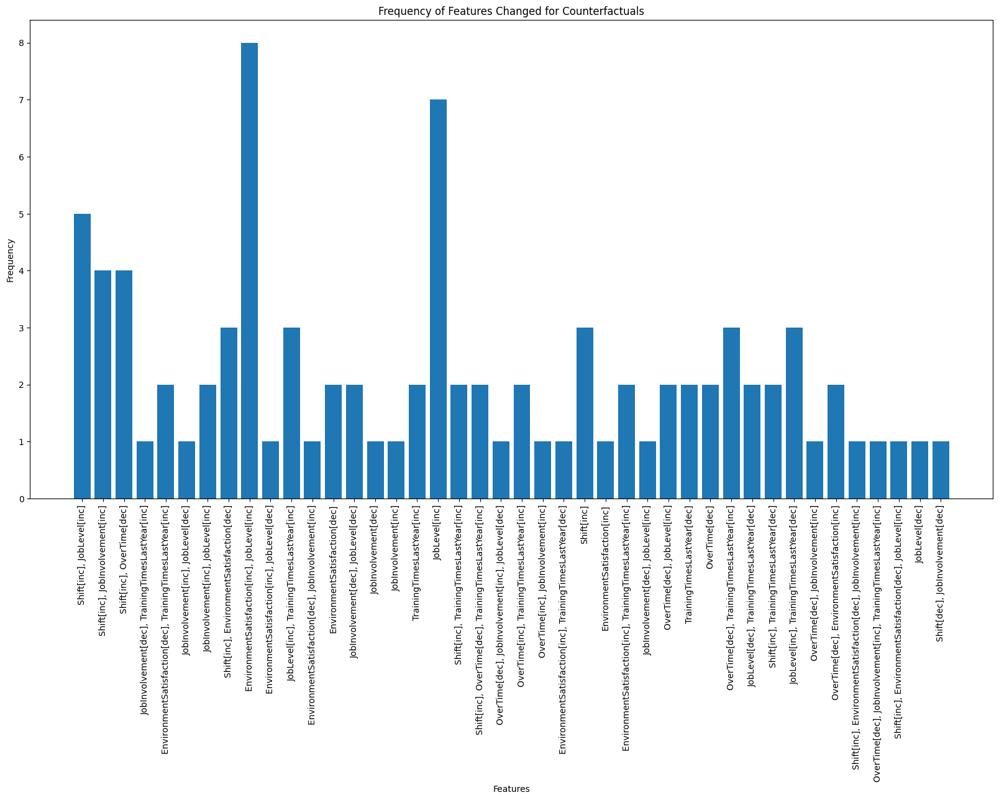

In [ ]:
# Flatten the list of lists
all_teams = [team for team in global_changable_cols]

all_teams_as_str = [', '.join(team) for team in all_teams]

# Count the frequency of each team
team_counts = Counter(team for team in all_teams_as_str)

# Extract the team names and counts for plotting
teams = list(team_counts.keys())
counts = list(team_counts.values())

# Create the bar plot
plt.figure(figsize=(20, 10))
plt.bar(teams, counts)
plt.xlabel("Features")
plt.ylabel("Frequency")
plt.title("Frequency of Features Changed for Counterfactuals")
plt.xticks(rotation=90)  # Rotate x-axis labels for better readability
plt.show()

100%|██████████| 1/1 [00:00<00:00,  1.92it/s]

Query instance (original outcome : 1.0)


,Age,BusinessTravel,DailyRate,DistanceFromHome,EnvironmentSatisfaction,HourlyRate,JobInvolvement,JobLevel,JobSatisfaction,MonthlyRate,...,Department_Neurology,EducationField_Marketing,EducationField_Other,JobRole_Administrative,JobRole_Nurse,JobRole_Other,JobRole_Therapist,MaritalStatus_Married,MaritalStatus_Single,Attrition
0,-0.946896,1.0,0.305787,0.463427,4.0,1.332198,2.0,1.0,1.0,-0.318523,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0



Diverse Counterfactual set (new outcome: 0.0)


,Age,BusinessTravel,DailyRate,DistanceFromHome,EnvironmentSatisfaction,HourlyRate,JobInvolvement,JobLevel,JobSatisfaction,MonthlyRate,...,Department_Neurology,EducationField_Marketing,EducationField_Other,JobRole_Administrative,JobRole_Nurse,JobRole_Other,JobRole_Therapist,MaritalStatus_Married,MaritalStatus_Single,Attrition
0,-,-,-,-,-,-,-,-,-,1445.77181,...,-,-,-,-,-,-,-,-,-,0.0
1,4.973788,-,-,-,-,-,-,-,-,-,...,-,-,-,-,-,-,-,-,-,0.0
2,-,-,-,-,-,-,-,2.0,-,-,...,-,-,-,-,-,-,-,-,-,0.0


100%|██████████| 1/1 [00:00<00:00,  2.40it/s]

Query instance (original outcome : 1.0)


,Age,BusinessTravel,DailyRate,DistanceFromHome,EnvironmentSatisfaction,HourlyRate,JobInvolvement,JobLevel,JobSatisfaction,MonthlyRate,...,Department_Neurology,EducationField_Marketing,EducationField_Other,JobRole_Administrative,JobRole_Nurse,JobRole_Other,JobRole_Therapist,MaritalStatus_Married,MaritalStatus_Single,Attrition
0,-0.946896,1.0,0.305787,0.463427,4.0,1.332198,2.0,1.0,1.0,-0.318523,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0



Diverse Counterfactual set (new outcome: 0.0)


,Age,BusinessTravel,DailyRate,DistanceFromHome,EnvironmentSatisfaction,HourlyRate,JobInvolvement,JobLevel,JobSatisfaction,MonthlyRate,...,Department_Neurology,EducationField_Marketing,EducationField_Other,JobRole_Administrative,JobRole_Nurse,JobRole_Other,JobRole_Therapist,MaritalStatus_Married,MaritalStatus_Single,Attrition
0,-,-,-,-,-,-,-,-,-,-,...,-,-,-,-,-,-,-,-,-,0.0
1,-,-,-,-,-,18.405787,-,-,-,-,...,-,-,-,-,-,-,-,-,-,0.0
2,-,-,-,-,-,-,3.0,-,-,-,...,-,-,-,-,-,-,-,-,-,0.0


100%|██████████| 1/1 [00:00<00:00,  1.43it/s]


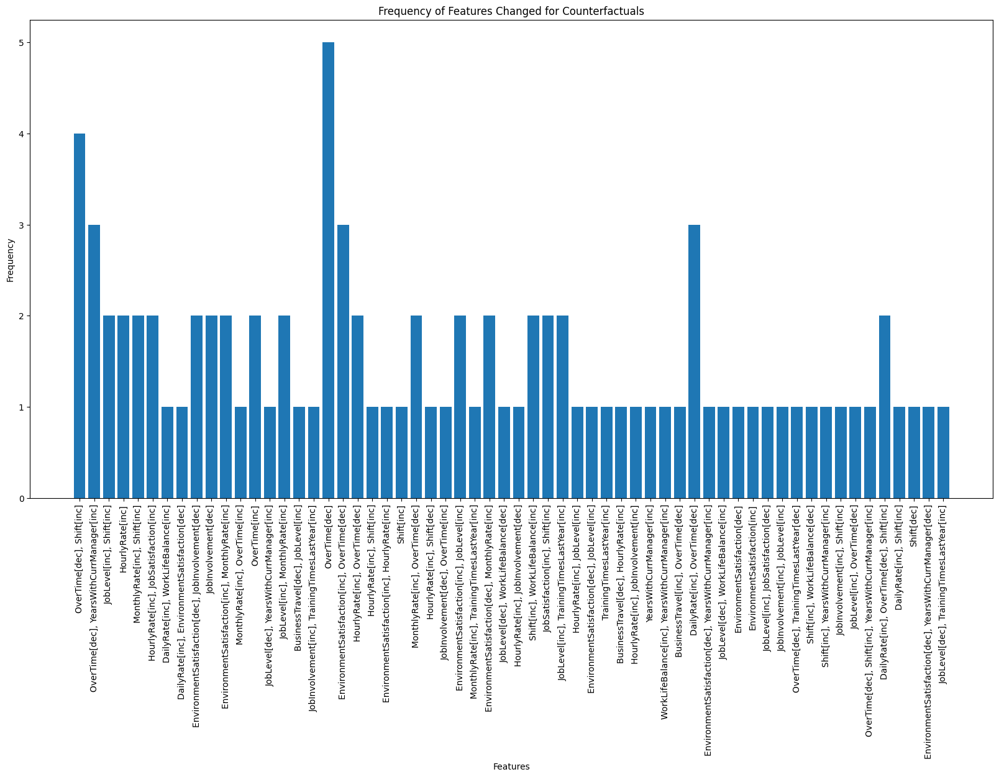

In [ ]:
## For best Ensemble Model
rf_dice = dice_ml.Model(model=best_ensemble_model,
                        # There exist backends for tf, torch, ...
                        backend="sklearn")
explainer = dice_ml.Dice(data_dice,
                         rf_dice,
                         # Random sampling, genetic algorithm, kd-tree,...
                         method="random")

# Generate CF based on the blackbox model
input_datapoint = X_test[1:2]
cf = explainer.generate_counterfactuals(input_datapoint,
                                  total_CFs=3,
                                  desired_class="opposite")

# Visualize it
cf.visualize_as_dataframe(show_only_changes=True)

cf = explainer.generate_counterfactuals(input_datapoint,
                                  total_CFs=3,
                                  desired_class="opposite",
                                  #permitted_range=permitted_range,
                                  features_to_vary=features_to_vary)
# Visualize it
cf.visualize_as_dataframe(show_only_changes=True)

global_changable_cols = []
y_test_series = pd.Series(y_test)
y_pred_series = pd.Series(y_pred)

for j in range(336):
  if y_test_series.iloc[j] == 0.0 or y_test_series.iloc[j] != y_pred_series.iloc[j]: # if not attrition or if it is not predicted correctly, we do not need to consider
    continue
  input_datapoint = X_test.iloc[j:j+1]
  cf = explainer.generate_counterfactuals(input_datapoint,
                                          total_CFs=3,
                                          desired_class="opposite",
                                          features_to_vary = features_to_vary)
  cf_df = cf.cf_examples_list[0].final_cfs_df
  cf_df.drop('Attrition', axis=1, inplace=True)
  cf_df_numpy = cf_df.to_numpy()

  for i in range(3):
    row = cf_df.iloc[i]
    changable_cols = []
    for col in row.index:
      if(row[col] != input_datapoint[col].values[0]):
        #print('\n')
        #print(col)
        additional = ""
        if(row[col] > input_datapoint[col].values[0]):
          additional = "[inc]"
        else:
          additional = "[dec]"
        changable_cols.append(col+additional)
        #print(row[col])
        #print(input_datapoint[col].values[0])
        #print('\n')
    global_changable_cols.append(changable_cols)
    #print('======')

# Flatten the list of lists
all_teams = [team for team in global_changable_cols]

all_teams_as_str = [', '.join(team) for team in all_teams]

# Count the frequency of each team
team_counts = Counter(team for team in all_teams_as_str)

# Extract the team names and counts for plotting
teams = list(team_counts.keys())
counts = list(team_counts.values())

# Create the bar plot
plt.figure(figsize=(20, 10))
plt.bar(teams, counts)
plt.xlabel("Features")
plt.ylabel("Frequency")
plt.title("Frequency of Features Changed for Counterfactuals")
plt.xticks(rotation=90)  # Rotate x-axis labels for better readability
plt.show()

# SHAP-Counterfactual

In [ ]:
# main_df = df

In [ ]:
# df = main_df

In [ ]:
combined_cols = ['Age',
  'Shift',
  'OverTime',
  'EnvironmentSatisfaction',
  'YearsInCurrentRole',
  'JobInvolvement',
  'JobLevel',
  'NumCompaniesWorked',
  'DistanceFromHome',
  'TrainingTimesLastYear',
  'TotalWorkingYears',
  'Attrition']

In [ ]:
df = df[combined_cols]

In [ ]:
continuous_features = [col for col in df.columns if df[col].nunique() > 8]

In [ ]:
# Create feasible (conditional) Counterfactuals
features_to_vary=['OverTime',
  'Shift',
  'EnvironmentSatisfaction',
  'JobInvolvement',
  'JobLevel',
  'TrainingTimesLastYear']

In [ ]:
cols_for_X = ['Age',
  'Shift',
  'OverTime',
  'EnvironmentSatisfaction',
  'YearsInCurrentRole',
  'JobInvolvement',
  'JobLevel',
  'NumCompaniesWorked',
  'DistanceFromHome',
  'TrainingTimesLastYear',
  'TotalWorkingYears']

In [ ]:
X_test = X_test[cols_for_X]

In [ ]:
model =  CatBoostClassifier(verbose=0, random_state=42)
X_train = X_train[cols_for_X]
model.fit(X_train, y_train)

In [ ]:
df = df[combined_cols]

100%|██████████| 1/1 [00:00<00:00,  9.02it/s]


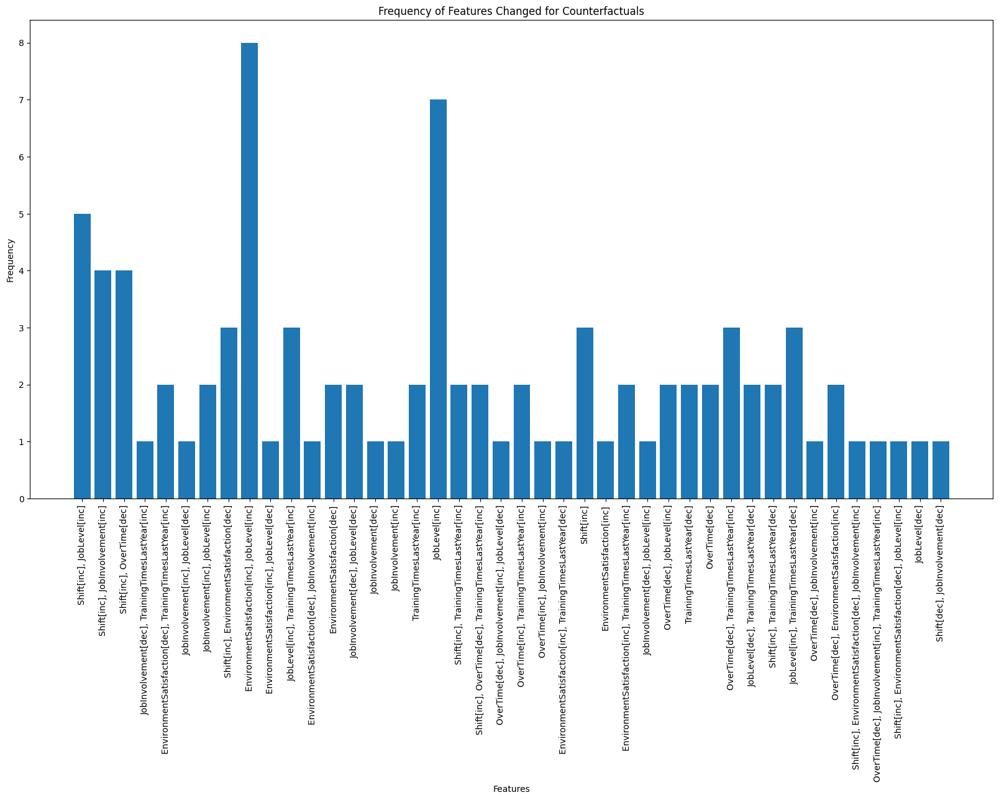

In [ ]:
# Dataset
data_dice = dice_ml.Data(dataframe=df,
                         # For perturbation strategy
                         continuous_features=continuous_features,
                         outcome_name='Attrition')

rf_dice = dice_ml.Model(model=model,
                        backend="sklearn")
explainer = dice_ml.Dice(data_dice,
                         rf_dice,
                         method="random")

global_changable_cols = []
y_test_series = pd.Series(y_test)
y_pred_series = pd.Series(y_pred)

for j in range(336):
  if y_test_series.iloc[j] == 0.0 or y_test_series.iloc[j] != y_pred_series.iloc[j]: # if not attrition or if it is not predicted correctly, we do not need to consider
    continue
  input_datapoint = X_test.iloc[j:j+1]
  cf = explainer.generate_counterfactuals(input_datapoint,
                                          total_CFs=3,
                                          desired_class="opposite",
                                          features_to_vary = features_to_vary)
  cf_df = cf.cf_examples_list[0].final_cfs_df
  cf_df.drop('Attrition', axis=1, inplace=True)
  cf_df_numpy = cf_df.to_numpy()

  for i in range(3):
    row = cf_df.iloc[i]
    changable_cols = []
    for col in row.index:
      if(row[col] != input_datapoint[col].values[0]):
        #print('\n')
        #print(col)
        additional = ""
        if(row[col] > input_datapoint[col].values[0]):
          additional = "[inc]"
        else:
          additional = "[dec]"
        changable_cols.append(col+additional)
        #print(row[col])
        #print(input_datapoint[col].values[0])
        #print('\n')
    global_changable_cols.append(changable_cols)
    #print('======')

# Flatten the list of lists
all_teams = [team for team in global_changable_cols]

all_teams_as_str = [', '.join(team) for team in all_teams]

# Count the frequency of each team
team_counts = Counter(team for team in all_teams_as_str)

# Extract the team names and counts for plotting
teams = list(team_counts.keys())
counts = list(team_counts.values())

# Create the bar plot
plt.figure(figsize=(20, 10))
plt.bar(teams, counts)
plt.xlabel("Features")
plt.ylabel("Frequency")
plt.title("Frequency of Features Changed for Counterfactuals")
plt.xticks(rotation=90)  # Rotate x-axis labels for better readability
plt.show()